In [3]:
!pip install kagglehub

     ---------------------------------------- 0.0/68.0 kB ? eta -:--:--
     ---------------------------------------- 68.0/68.0 kB 1.9 MB/s eta 0:00:00
     ---------------------------------------- 0.0/161.8 kB ? eta -:--:--
     ------------------------------------- 161.8/161.8 kB 10.1 MB/s eta 0:00:00



[notice] A new release of pip is available: 23.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [1]:
import os
import glob
import random
import itertools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch.nn as nn
import torch
import torchvision
import torch.optim as optim
from torchvision import transforms, models
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from tqdm import tqdm

In [25]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("moazeldsokyx/dogs-vs-cats")

print("Path to dataset files:", path)

Path to dataset files: C:\Users\Alexs\.cache\kagglehub\datasets\moazeldsokyx\dogs-vs-cats\versions\1


In [26]:
train_path = os.path.join(path, "dataset//train")
test_path = os.path.join(path, "dataset//test")

In [ ]:
def display_images(folder_path, num_images=15, rows=3, cols=5, figsize=(15, 6)):
    classes = os.listdir(folder_path)
    
    # Собираем все пути к изображениям (формат .jpg)
    image_paths = []
    for class_name in classes:
        class_path = os.path.join(folder_path, class_name)
        image_paths.extend(glob.glob(f"{class_path}/*.jpg"))
    
    # Выбираем случайные изображения
    selected_images = random.sample(image_paths, min(num_images, len(image_paths)))
    
    # Создаем сетку для отображения
    fig, axs = plt.subplots(rows, cols, figsize=figsize)
    axs = axs.flatten()  # Преобразуем в 1D массив для удобства
    
    for i, img_path in enumerate(selected_images):
        if i >= len(axs):  # Если изображений больше, чем ячеек
            break
        
        img = Image.open(img_path)
        axs[i].imshow(img)
        
        # Извлекаем название класса из пути (работает на Windows/Linux)
        class_name = os.path.basename(os.path.dirname(img_path))
        axs[i].set_title(class_name)
        axs[i].axis('off')
    
    # Скрываем лишние оси, если изображений меньше, чем ячеек
    for j in range(i + 1, len(axs)):
        axs[j].axis('off')
    
    plt.tight_layout()
    plt.show()

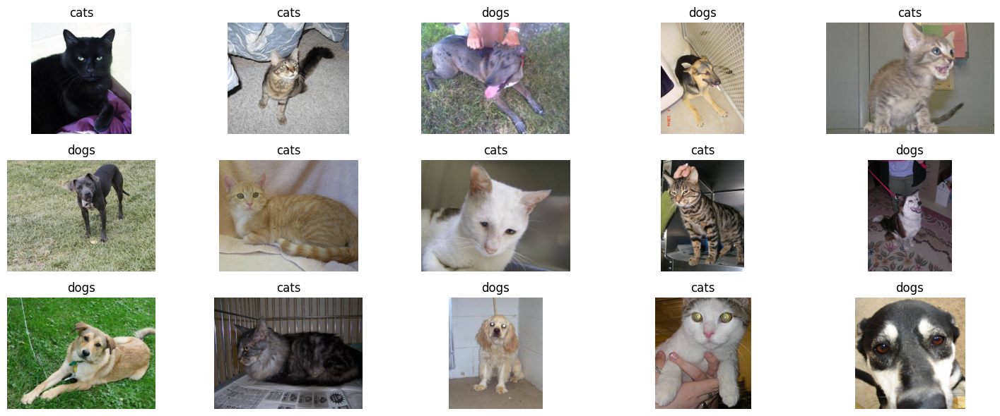

In [20]:
display_images(train_path)

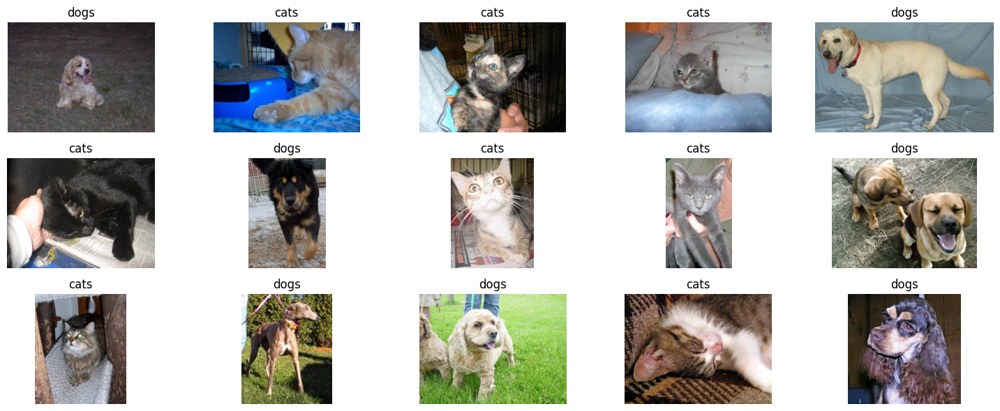

In [33]:
display_images(test_path)

In [28]:
# Аугментации для обучающей выборки (с рандомизацией)
train_augmentations = transforms.Compose([
    transforms.Resize(size=(256, 256)),  # Стандартный размер
    transforms.RandomHorizontalFlip(),    # Случайное зеркальное отражение
    transforms.RandomApply([transforms.RandomRotation(degrees=10)], p=0.5),  # Поворот на ±10°
    transforms.RandomApply([transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1)], p=0.5),
    transforms.ToTensor(),  # Преобразование в тензор
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Нормализация ImageNet
])

# Преобразования для тестовой/валидационной выборки (без аугментаций)
test_augmentations = transforms.Compose([
    transforms.Resize(size=(256, 256)),  # Тот же размер, что и в train
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [30]:
train_ds = torchvision.datasets.ImageFolder(train_path, transform=train_augmentations)
test_ds = torchvision.datasets.ImageFolder(test_path, transform=test_augmentations)
train_ds, test_ds

(Dataset ImageFolder
     Number of datapoints: 20000
     Root location: C:\Users\Alexs\.cache\kagglehub\datasets\moazeldsokyx\dogs-vs-cats\versions\1\dataset//train
     StandardTransform
 Transform: Compose(
                Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
                RandomHorizontalFlip(p=0.5)
                RandomApply(
                p=0.5
                RandomRotation(degrees=[-10.0, 10.0], interpolation=nearest, expand=False, fill=0)
            )
                RandomApply(
                p=0.5
                ColorJitter(brightness=(0.9, 1.1), contrast=(0.9, 1.1), saturation=(0.9, 1.1), hue=(-0.1, 0.1))
            )
                ToTensor()
                Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
            ),
 Dataset ImageFolder
     Number of datapoints: 12461
     Root location: C:\Users\Alexs\.cache\kagglehub\datasets\moazeldsokyx\dogs-vs-cats\versions\1\dataset//test
     StandardTransfo

In [31]:
train_dataloader = DataLoader(train_ds, batch_size=32, shuffle=True)
test_dataloader = DataLoader(test_ds, batch_size=32)

In [34]:
model = models.resnet18(weights='DEFAULT')

# Замораживаем все параметры модели
for param in model.parameters():
    param.requires_grad = False

# Заменяем последний полносвязный слой (под нашу задачу)
num_classes = len(train_ds.classes)  # Предполагается, что train_ds определён ранее
model.fc = nn.Linear(model.fc.in_features, num_classes)

# Размораживаем параметры нового классификатора
for param in model.fc.parameters():
    param.requires_grad = True

In [36]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device
model = model.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(model.parameters(), lr=0.0001)

In [ ]:
def train_epoch(model, data_loader, loss_fn, optimizer, device):
    model.train()  # Переводим модель в режим обучения
    running_loss = 0.0
    
    for batch in tqdm(data_loader, desc="Training"):
        inputs, targets = batch[0].to(device), batch[1].to(device)
        
        # Обнуляем градиенты
        optimizer.zero_grad()
        
        # Прямой проход
        predictions = model(inputs)
        loss = loss_fn(predictions, targets)
        
        # Обратный проход и оптимизация
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()
    
    return running_loss / len(data_loader)

def evaluate_model(model, data_loader, loss_fn, device):
    model.eval()  # Переводим модель в режим оценки
    total_loss = 0.0
    correct_predictions = 0
    
    with torch.no_grad():  # Отключаем вычисление градиентов
        for batch in tqdm(data_loader, desc="Evaluating"):
            inputs, targets = batch[0].to(device), batch[1].to(device)
            
            # Прямой проход
            outputs = model(inputs)
            loss = loss_fn(outputs, targets)
            total_loss += loss.item()
            
            # Вычисляем точность
            _, predicted = torch.max(outputs, 1)
            correct_predictions += (predicted == targets).sum().item()
    
    avg_loss = total_loss / len(data_loader)
    accuracy = 100 * correct_predictions / len(data_loader.dataset)
    return avg_loss, accuracy

In [39]:
def train(model, train_dataloader, test_dataloader, criterion, optimizer, num_epochs=10):

    for epoch in range(num_epochs):

        train_loss = train_one_epoch(model, train_dataloader, criterion, optimizer)
        test_loss, accuracy = test(model, test_dataloader, criterion)

        print(f'Epoch: {epoch+1}/{num_epochs} | Train Loss: {train_loss:.4f} | Test Loss: {test_loss:.4f} | Accuracy:{accuracy:.2f}%')

In [41]:
train(model, train_dataloader, test_dataloader, criterion, optimizer, 5)

100%|██████████| 390/390 [04:37<00:00,  1.40it/s]


Epoch: 1/5 | Train Loss: 0.2735 | Test Loss: 0.1324 | Accuracy:97.14%


100%|██████████| 390/390 [03:26<00:00,  1.88it/s]


Epoch: 2/5 | Train Loss: 0.1376 | Test Loss: 0.0864 | Accuracy:97.82%


100%|██████████| 390/390 [03:23<00:00,  1.92it/s]


Epoch: 3/5 | Train Loss: 0.1126 | Test Loss: 0.0701 | Accuracy:98.02%


100%|██████████| 390/390 [03:27<00:00,  1.88it/s]


Epoch: 4/5 | Train Loss: 0.0982 | Test Loss: 0.0622 | Accuracy:98.06%


100%|██████████| 390/390 [03:28<00:00,  1.87it/s]

Epoch: 5/5 | Train Loss: 0.0934 | Test Loss: 0.0569 | Accuracy:98.19%


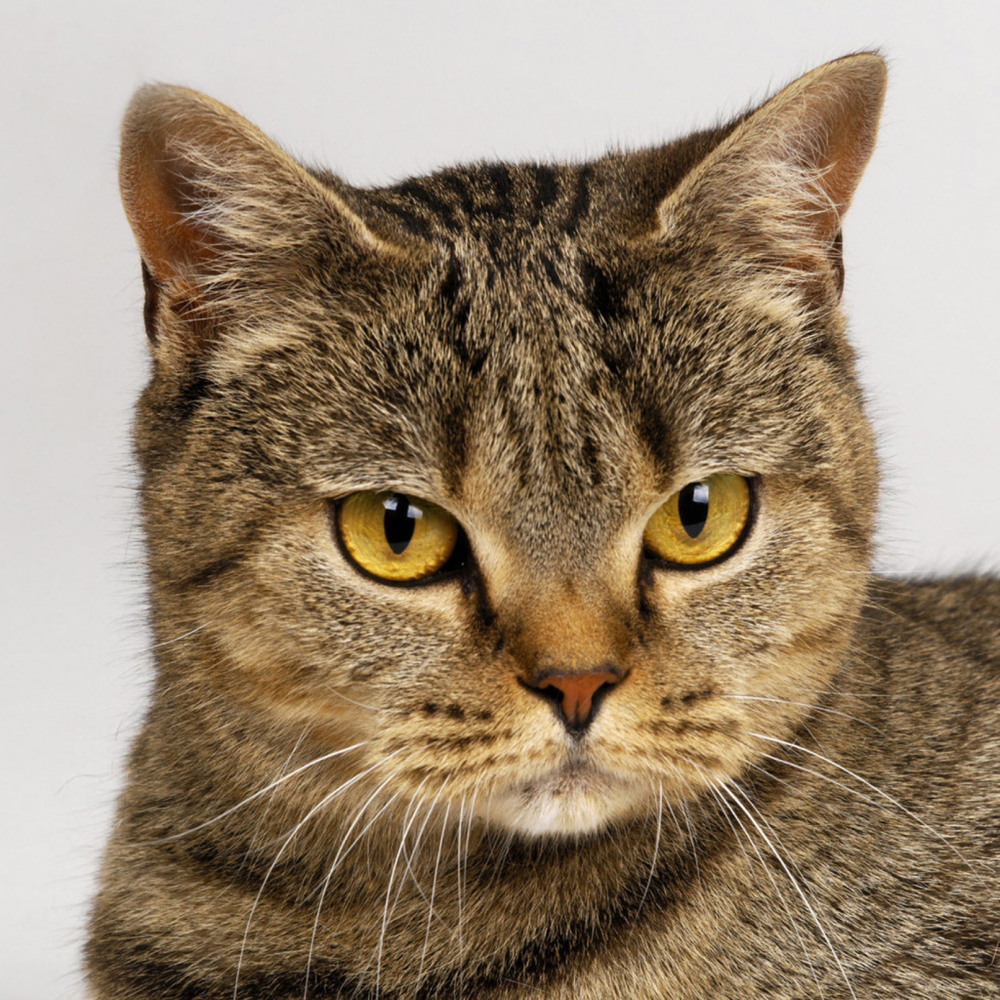

In [51]:
img_example = img_path = os.path.join(os.getcwd(), "example", "example1.jpg")
img = Image.open(img_example)
img

In [52]:
img = test_augmentations(img)
output = model(img.unsqueeze(0).to(device))
torch.argmax(output).item()

0

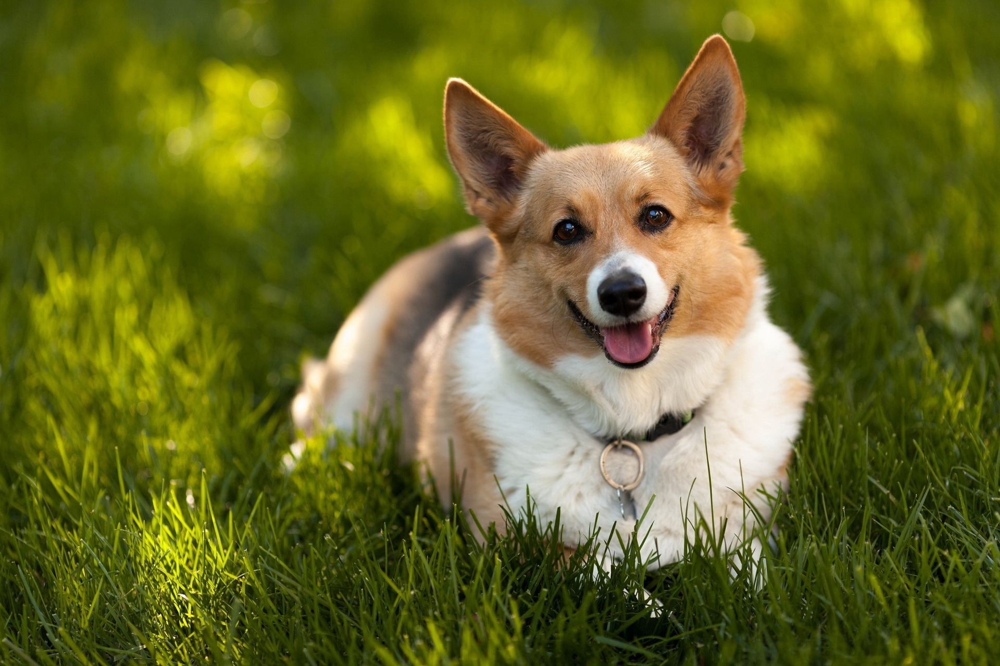

In [53]:
img_example = img_path = os.path.join(os.getcwd(), "example", "example2.jpg")
img = Image.open(img_example)
img

In [55]:
img = test_augmentations(img)
output = model(img.unsqueeze(0).to(device))
torch.argmax(output).item()

1

100%|██████████| 1000/1000 [00:35<00:00, 28.48it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


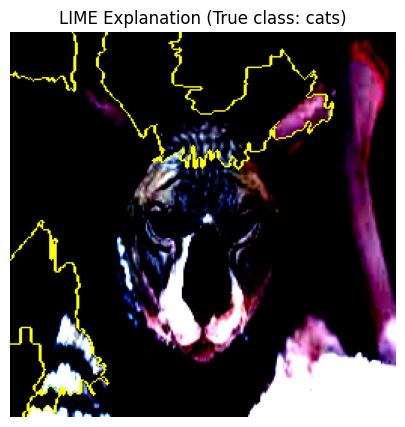

In [25]:
import lime
from lime import lime_image
import shap
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

def get_test_image():
    random_idx = random.randint(0, len(test_ds)-1)
    image, label = test_ds[random_idx]
    return image.unsqueeze(0).to(device), label, random_idx

test_image, true_label, idx = get_test_image()

model_cpu = model.to('cpu')
test_image_cpu = test_image.to('cpu')


def lime_explanation(image, model, top_labels=5, hide_color=0, num_samples=1000):
    
    def batch_predict(images):
        model.eval()
        batch = torch.stack([
            transforms.functional.to_tensor(img) for img in images
        ]).float()
        batch = transforms.functional.normalize(
            batch, 
            mean=[0.485, 0.456, 0.406], 
            std=[0.229, 0.224, 0.225]
        )
        device = next(model.parameters()).device
        batch = batch.to(device)
        
        with torch.no_grad():
            logits = model(batch)
            probs = torch.nn.functional.softmax(logits, dim=1)
        return probs.detach().cpu().numpy()
    
    explainer = lime_image.LimeImageExplainer()
    explanation = explainer.explain_instance(
        image[0].permute(1, 2, 0).cpu().numpy(), 
        batch_predict,
        top_labels=top_labels, 
        hide_color=hide_color, 
        num_samples=num_samples
    )
    return explanation

test_image, true_label, idx = get_test_image()
test_image_cpu = test_image.cpu()

lime_exp = lime_explanation(test_image_cpu, model.to('cpu'))

plt.figure(figsize=(10, 5))
temp, mask = lime_exp.get_image_and_mask(
    lime_exp.top_labels[0], 
    positive_only=True, 
    num_features=5, 
    hide_rest=False
)
plt.imshow(mark_boundaries(temp, mask))
plt.title(f'LIME Explanation (True class: {test_ds.classes[true_label]})')
plt.axis('off')
plt.show()

100%|██████████| 1000/1000 [00:34<00:00, 28.75it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..1.8550389].


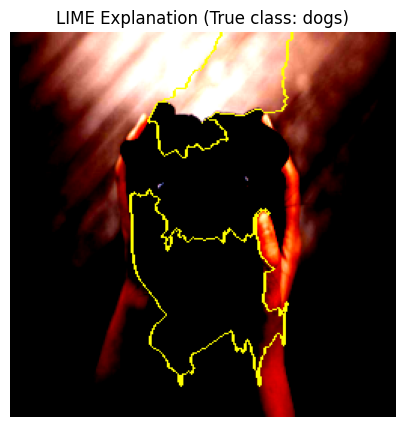

In [26]:
test_image, true_label, idx = get_test_image()
test_image_cpu = test_image.cpu()

lime_exp = lime_explanation(test_image_cpu, model.to('cpu'))

plt.figure(figsize=(10, 5))
temp, mask = lime_exp.get_image_and_mask(
    lime_exp.top_labels[0], 
    positive_only=True, 
    num_features=5, 
    hide_rest=False
)
plt.imshow(mark_boundaries(temp, mask))
plt.title(f'LIME Explanation (True class: {test_ds.classes[true_label]})')
plt.axis('off')
plt.show()

100%|██████████| 1000/1000 [00:37<00:00, 26.81it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0322802..2.64].


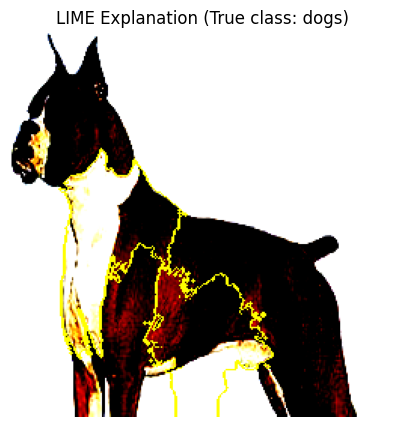

In [27]:
test_image, true_label, idx = get_test_image()
test_image_cpu = test_image.cpu()

lime_exp = lime_explanation(test_image_cpu, model.to('cpu'))

plt.figure(figsize=(10, 5))
temp, mask = lime_exp.get_image_and_mask(
    lime_exp.top_labels[0], 
    positive_only=True, 
    num_features=5, 
    hide_rest=False
)
plt.imshow(mark_boundaries(temp, mask))
plt.title(f'LIME Explanation (True class: {test_ds.classes[true_label]})')
plt.axis('off')
plt.show()

100%|██████████| 1000/1000 [00:36<00:00, 27.45it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.4308496].


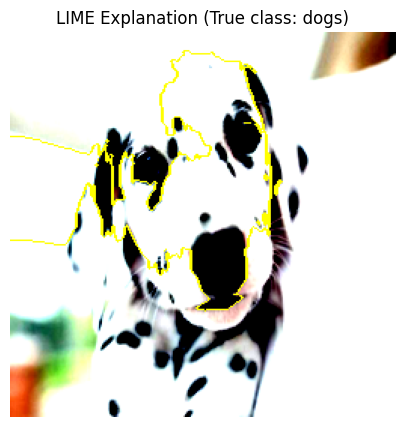

In [28]:
test_image, true_label, idx = get_test_image()
test_image_cpu = test_image.cpu()

lime_exp = lime_explanation(test_image_cpu, model.to('cpu'))

plt.figure(figsize=(10, 5))
temp, mask = lime_exp.get_image_and_mask(
    lime_exp.top_labels[0], 
    positive_only=True, 
    num_features=5, 
    hide_rest=False
)
plt.imshow(mark_boundaries(temp, mask))
plt.title(f'LIME Explanation (True class: {test_ds.classes[true_label]})')
plt.axis('off')
plt.show()

100%|██████████| 1000/1000 [00:37<00:00, 26.35it/s]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


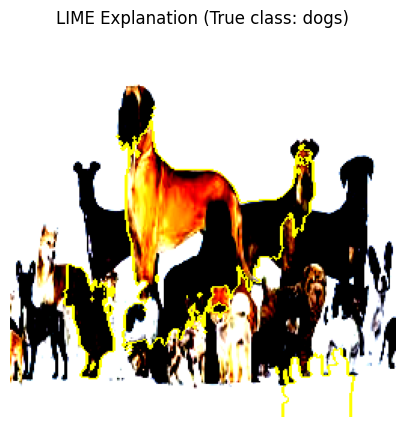

In [29]:
test_image, true_label, idx = get_test_image()
test_image_cpu = test_image.cpu()

lime_exp = lime_explanation(test_image_cpu, model.to('cpu'))

plt.figure(figsize=(10, 5))
temp, mask = lime_exp.get_image_and_mask(
    lime_exp.top_labels[0], 
    positive_only=True, 
    num_features=5, 
    hide_rest=False
)
plt.imshow(mark_boundaries(temp, mask))
plt.title(f'LIME Explanation (True class: {test_ds.classes[true_label]})')
plt.axis('off')
plt.show()

# Вывод
В ходе выполнения курсовой работы была исследована возможность применения методов интерпретируемого машинного обучения (LIME и SHAP) для анализа предсказаний сверточной нейронной сети (CNN), обученной на датасете «Cats vs. Dogs». Lime нагляднейшим образом показал, как модель принимает решения, а Shap был протестирован на собственных изображениях.